<a href="https://colab.research.google.com/github/bevul/Book-cover-generation/blob/main/Book_cover_generation_VQGAN%2BCLIP(Updated).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Generate images from text phrases with VQGAN and CLIP  in order to produce a book cover.

Notebook by Katherine Crowson (https://github.com/crowsonkb, https://twitter.com/RiversHaveWings). 

The original BigGAN + CLIP method was made by https://twitter.com/advadnoun. Translated and added explanations, and modifications by Eleiber # 8347, and the friendly interface was made thanks to Abulafia # 3734 and Ekaterina Bayagantaeva.

For a detailed tutorial on how to use it, I recommend [visit this article] (https://yourcriatures.miraheze.org/wiki/Help:Create_images_with_VQGAN+CLIP), made by Jakeukalane # 2767 and Avengium (Angel) # 3715

Modified by: Justin John and Ekaterina Bayagantaeva


In [ ]:
# @title License
# @markdown **Licensed under the MIT License (*Double-click me to read the license agreement*)**
#@markdown ---

# Copyright (c) 2021 Katherine Crowson

# Permission is hereby granted, free of charge, to any person obtaining a copy
# of this software and associated documentation files (the "Software"), to deal
# in the Software without restriction, including without limitation the rights
# to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
# copies of the Software, and to permit persons to whom the Software is
# furnished to do so, subject to the following conditions:

# The above copyright notice and this permission notice shall be included in
# all copies or substantial portions of the Software.

# THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
# IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
# FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
# AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
# LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
# OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN
# THE SOFTWARE.

In [ ]:
# @title Check GPU type

#@markdown ### Factory reset runtime if you don't have the desired GPU.

#@markdown ---




#@markdown V100 = Excellent (*Available only for Colab Pro users*)

#@markdown P100 = Very Good

#@markdown T4 = Good (*preferred*)

#@markdown K80 = Meh

#@markdown P4 = (*Not Recommended*) 

#@markdown ---

!nvidia-smi -L

GPU 0: Tesla T4 (UUID: GPU-7a74ff4f-84c9-1645-1bf7-d1262660e92c)


In [ ]:
# @title Anti-Disconnect for Google Colab
#@markdown ## Run this to stop it from disconnecting automatically 
#@markdown  **(disconnects anyhow after 6 - 12 hrs for using the free version of Colab.)**
#@markdown  *(Pro users will get about 24 hrs usage time[depends])*
#@markdown ---

import IPython
js_code = '''
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}
setInterval(ClickConnect,60000)
'''
display(IPython.display.Javascript(js_code))

<IPython.core.display.Javascript object>

# Installation

In [ ]:
# @title Installation of libraries
# @markdown This cell will take a little while because it has to download several libraries

#@markdown ---
 
print("Installing CLIP...")
!git clone https://github.com/openai/CLIP                 &> /dev/null
 
print("Installing Python Libraries for AI...")
!git clone https://github.com/CompVis/taming-transformers &> /dev/null
!pip install transformers                                 &> /dev/null
!pip install ftfy regex tqdm omegaconf pytorch-lightning  &> /dev/null
!pip install kornia                                       &> /dev/null
!pip install einops                                       &> /dev/null
!pip install wget                                         &> /dev/null
 
print("Installing libraries for metadata management...")
!pip install stegano                                      &> /dev/null
!apt install exempi                                       &> /dev/null
!pip install python-xmp-toolkit                           &> /dev/null
!pip install imgtag                                       &> /dev/null
!pip install pillow==7.1.2                                &> /dev/null
 
print("Installing Python libraries for creating videos...")
!pip install imageio-ffmpeg                               &> /dev/null
!mkdir steps
print("Installation completed.")

Installing CLIP...
Installing Python Libraries for AI...
Installing libraries for metadata management...
Installing Python libraries for creating videos...
Installation completed.


In [ ]:
# @title Selection of models to download
#@markdown ---

#@markdown By default, the notebook downloads Model 16384 from ImageNet. There are others that are not downloaded by default, since it would be in vain if you are not going to use them, so if you want to use them, simply select the models to download.

#@markdown ---

#imagenet_1024 = False #@param {type:"boolean"}
#imagenet_16384 = False #@param {type:"boolean"}
#gumbel_8192 = False #@param {type:"boolean"}
#coco = False #@param {type:"boolean"}
#faceshq = False #@param {type:"boolean"}
wikiart_1024 = False #@param {type:"boolean"}
wikiart_16384 = True #@param {type:"boolean"}
#sflckr = False #@param {type:"boolean"}
#ade20k = False #@param {type:"boolean"}
#ffhq = False #@param {type:"boolean"}
#celebahq = False #@param {type:"boolean"}


if wikiart_1024: 
  !curl -L -o wikiart_1024.yaml -C - 'http://mirror.io.community/blob/vqgan/wikiart.yaml' #WikiArt 1024
  !curl -L -o wikiart_1024.ckpt -C - 'http://mirror.io.community/blob/vqgan/wikiart.ckpt' #WikiArt 1024
if wikiart_16384: 
  !curl -L -o wikiart_16384.yaml -C - 'http://eaidata.bmk.sh/data/Wikiart_16384/wikiart_f16_16384_8145600.yaml' #WikiArt 16384
  !curl -L -o wikiart_16384.ckpt -C - 'http://eaidata.bmk.sh/data/Wikiart_16384/wikiart_f16_16384_8145600.ckpt' #WikiArt 16384


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   920  100   920    0     0   2666      0 --:--:-- --:--:-- --:--:--  2674
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  958M  100  958M    0     0  6384k      0  0:02:33  0:02:33 --:--:-- 6536k


In [ ]:
# @title Loading libraries and definitions
 
import argparse
import math
from pathlib import Path
import sys
 
sys.path.append('./taming-transformers')
from IPython import display
from base64 import b64encode
from omegaconf import OmegaConf
from PIL import Image
from taming.models import cond_transformer, vqgan
import torch
from torch import nn, optim
from torch.nn import functional as F
from torchvision import transforms
from torchvision.transforms import functional as TF
from tqdm.notebook import tqdm
 
from CLIP import clip
import kornia.augmentation as K
import numpy as np
import imageio
from PIL import ImageFile, Image
from imgtag import ImgTag    # metadatos 
from libxmp import *         # metadatos
import libxmp                # metadatos
from stegano import lsb
import json
ImageFile.LOAD_TRUNCATED_IMAGES = True
 
def sinc(x):
    return torch.where(x != 0, torch.sin(math.pi * x) / (math.pi * x), x.new_ones([]))
 
 
def lanczos(x, a):
    cond = torch.logical_and(-a < x, x < a)
    out = torch.where(cond, sinc(x) * sinc(x/a), x.new_zeros([]))
    return out / out.sum()
 
 
def ramp(ratio, width):
    n = math.ceil(width / ratio + 1)
    out = torch.empty([n])
    cur = 0
    for i in range(out.shape[0]):
        out[i] = cur
        cur += ratio
    return torch.cat([-out[1:].flip([0]), out])[1:-1]
 
 
def resample(input, size, align_corners=True):
    n, c, h, w = input.shape
    dh, dw = size
 
    input = input.view([n * c, 1, h, w])
 
    if dh < h:
        kernel_h = lanczos(ramp(dh / h, 2), 2).to(input.device, input.dtype)
        pad_h = (kernel_h.shape[0] - 1) // 2
        input = F.pad(input, (0, 0, pad_h, pad_h), 'reflect')
        input = F.conv2d(input, kernel_h[None, None, :, None])
 
    if dw < w:
        kernel_w = lanczos(ramp(dw / w, 2), 2).to(input.device, input.dtype)
        pad_w = (kernel_w.shape[0] - 1) // 2
        input = F.pad(input, (pad_w, pad_w, 0, 0), 'reflect')
        input = F.conv2d(input, kernel_w[None, None, None, :])
 
    input = input.view([n, c, h, w])
    return F.interpolate(input, size, mode='bicubic', align_corners=align_corners)
 
 
class ReplaceGrad(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x_forward, x_backward):
        ctx.shape = x_backward.shape
        return x_forward
 
    @staticmethod
    def backward(ctx, grad_in):
        return None, grad_in.sum_to_size(ctx.shape)
 
 
replace_grad = ReplaceGrad.apply
 
 
class ClampWithGrad(torch.autograd.Function):
    @staticmethod
    def forward(ctx, input, min, max):
        ctx.min = min
        ctx.max = max
        ctx.save_for_backward(input)
        return input.clamp(min, max)
 
    @staticmethod
    def backward(ctx, grad_in):
        input, = ctx.saved_tensors
        return grad_in * (grad_in * (input - input.clamp(ctx.min, ctx.max)) >= 0), None, None
 
 
clamp_with_grad = ClampWithGrad.apply
 
 
def vector_quantize(x, codebook):
    d = x.pow(2).sum(dim=-1, keepdim=True) + codebook.pow(2).sum(dim=1) - 2 * x @ codebook.T
    indices = d.argmin(-1)
    x_q = F.one_hot(indices, codebook.shape[0]).to(d.dtype) @ codebook
    return replace_grad(x_q, x)
 
 
class Prompt(nn.Module):
    def __init__(self, embed, weight=1., stop=float('-inf')):
        super().__init__()
        self.register_buffer('embed', embed)
        self.register_buffer('weight', torch.as_tensor(weight))
        self.register_buffer('stop', torch.as_tensor(stop))
 
    def forward(self, input):
        input_normed = F.normalize(input.unsqueeze(1), dim=2)
        embed_normed = F.normalize(self.embed.unsqueeze(0), dim=2)
        dists = input_normed.sub(embed_normed).norm(dim=2).div(2).arcsin().pow(2).mul(2)
        dists = dists * self.weight.sign()
        return self.weight.abs() * replace_grad(dists, torch.maximum(dists, self.stop)).mean()
 
 
def parse_prompt(prompt):
    vals = prompt.rsplit(':', 2)
    vals = vals + ['', '1', '-inf'][len(vals):]
    return vals[0], float(vals[1]), float(vals[2])
 
 
class MakeCutouts(nn.Module):
    def __init__(self, cut_size, cutn, cut_pow=1.):
        super().__init__()
        self.cut_size = cut_size
        self.cutn = cutn
        self.cut_pow = cut_pow
        self.augs = nn.Sequential(
            K.RandomHorizontalFlip(p=0.5),
            # K.RandomSolarize(0.01, 0.01, p=0.7),
            K.RandomSharpness(0.3,p=0.4),
            K.RandomAffine(degrees=30, translate=0.1, p=0.8, padding_mode='border'),
            K.RandomPerspective(0.2,p=0.4),
            K.ColorJitter(hue=0.01, saturation=0.01, p=0.7))
        self.noise_fac = 0.1
 
 
    def forward(self, input):
        sideY, sideX = input.shape[2:4]
        max_size = min(sideX, sideY)
        min_size = min(sideX, sideY, self.cut_size)
        cutouts = []
        for _ in range(self.cutn):
            size = int(torch.rand([])**self.cut_pow * (max_size - min_size) + min_size)
            offsetx = torch.randint(0, sideX - size + 1, ())
            offsety = torch.randint(0, sideY - size + 1, ())
            cutout = input[:, :, offsety:offsety + size, offsetx:offsetx + size]
            cutouts.append(resample(cutout, (self.cut_size, self.cut_size)))
        batch = self.augs(torch.cat(cutouts, dim=0))
        if self.noise_fac:
            facs = batch.new_empty([self.cutn, 1, 1, 1]).uniform_(0, self.noise_fac)
            batch = batch + facs * torch.randn_like(batch)
        return batch
 
 
def load_vqgan_model(config_path, checkpoint_path):
    config = OmegaConf.load(config_path)
    if config.model.target == 'taming.models.vqgan.VQModel':
        model = vqgan.VQModel(**config.model.params)
        model.eval().requires_grad_(False)
        model.init_from_ckpt(checkpoint_path)
    elif config.model.target == 'taming.models.cond_transformer.Net2NetTransformer':
        parent_model = cond_transformer.Net2NetTransformer(**config.model.params)
        parent_model.eval().requires_grad_(False)
        parent_model.init_from_ckpt(checkpoint_path)
        model = parent_model.first_stage_model
    elif config.model.target == 'taming.models.vqgan.GumbelVQ':
        model = vqgan.GumbelVQ(**config.model.params)
        print(config.model.params)
        model.eval().requires_grad_(False)
        model.init_from_ckpt(checkpoint_path)
    else:
        raise ValueError(f'unknown model type: {config.model.target}')
    del model.loss
    return model
 
 
def resize_image(image, out_size):
    ratio = image.size[0] / image.size[1]
    area = min(image.size[0] * image.size[1], out_size[0] * out_size[1])
    size = round((area * ratio)**0.5), round((area / ratio)**0.5)
    return image.resize(size, Image.LANCZOS)

def download_img(img_url):
    try:
        return wget.download(img_url,out="input.jpg")
    except:
        return


# Tools for execution:
Mainly what you will have to modify will be `texts:`, there you can place the text (s) you want to generate (separated with `|`). It is a list because you can put more than one text, and so the AI ​​tries to 'mix' the images, giving the same priority to both texts.

To use an initial image to the model, you just have to upload a file to the Colab environment (in the section on the left), and then modify `init_image:` putting the exact name of the file. Example: `sample.png`

You can also modify the model by changing the lines that say `model:`. Currently 1024, 16384, WikiArt, S-FLCKR and COCO-Stuff are available. To activate them you have to have downloaded them first, and then you can simply select it.

You can also use `target_images`, which is basically putting one or more images on it that the AI ​​will take as a "target", fulfilling the same function as putting text on it. To put more than one you have to use `|` as a separator.

In [ ]:
# @title Parameters
#@markdown ---
texts = "Dragon, ice, fire" #@param {type:"string"}
width =  400#@param {type:"number"}
height =  500#@param {type:"number"}
model = "wikiart_16384" #@param ["vqgan_imagenet_f16_16384", "vqgan_imagenet_f16_1024", "wikiart_1024", "wikiart_16384", "coco", "faceshq", "sflckr", "ade20k", "ffhq", "celebahq", "gumbel_8192"]
images_interval =  20#@param {type:"number"}
seed = 15223976836775396427#@param {type:"number"}
max_iterations = 380#@param {type:"number"}
input_images = ""

init_image = "None"
target_images = "None"

model_names={"vqgan_imagenet_f16_16384": 'ImageNet 16384',"vqgan_imagenet_f16_1024":"ImageNet 1024", 
                 "wikiart_1024":"WikiArt 1024", "wikiart_16384":"WikiArt 16384", "coco":"COCO-Stuff", "faceshq":"FacesHQ", "sflckr":"S-FLCKR", "ade20k":"ADE20K", "ffhq":"FFHQ", "celebahq":"CelebA-HQ", "gumbel_8192": "Gumbel 8192"}
name_model = model_names[model]     

if model == "gumbel_8192":
    is_gumbel = True
else:
    is_gumbel = False

if seed == -1:
    seed = None
if init_image == "None":
    init_image = None
elif init_image and init_image.lower().startswith("http"):
    init_image = download_img(init_image)


if target_images == "None" or not target_images:
    target_images = []
else:
    target_images = target_images.split("|")
    target_images = [image.strip() for image in target_images]

if init_image or target_images != []:
    input_images = True

texts = [frase.strip() for frase in texts.split("|")]
if texts == ['']:
    texts = []


args = argparse.Namespace(
    prompts=texts,
    image_prompts=target_images,
    noise_prompt_seeds=[],
    noise_prompt_weights=[],
    size=[width, height],
    init_image=init_image,
    init_weight=0.,
    clip_model='ViT-B/32',
    vqgan_config=f'{model}.yaml',
    vqgan_checkpoint=f'{model}.ckpt',
    step_size=0.1,
    #cutn=64,
    cutn=15,
    cut_pow=1.,
    display_freq=images_interval,
    seed=seed,
)

In [ ]:
torch.cuda.empty_cache()

Using device: cuda:0
Using texts: ['Dragon, ice, fire']
Using seed: 15223976836775396427
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

8.19kB [00:00, 473kB/s]                    


loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.
Restored from wikiart_16384.ckpt


100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 200MiB/s]


0it [00:00, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


i: 0, loss: 0.94403, losses: 0.94403


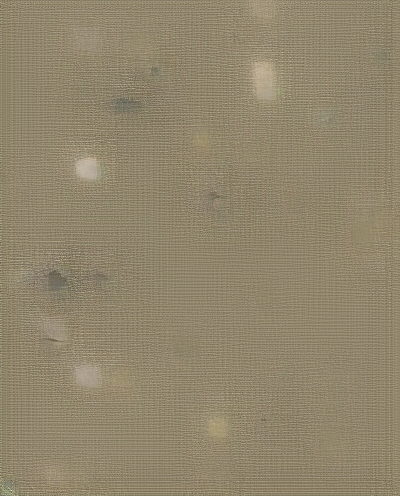

i: 20, loss: 0.875861, losses: 0.875861


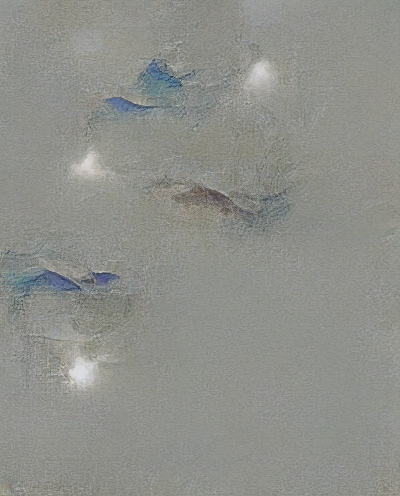

i: 40, loss: 0.793164, losses: 0.793164


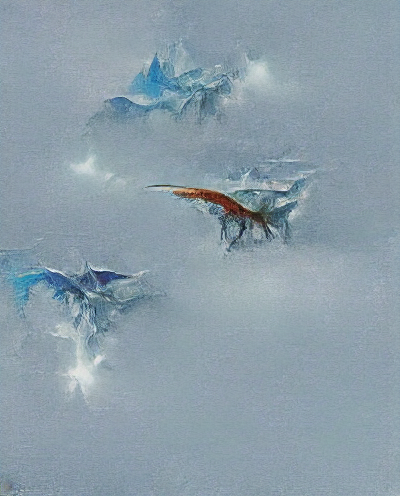

i: 60, loss: 0.739142, losses: 0.739142


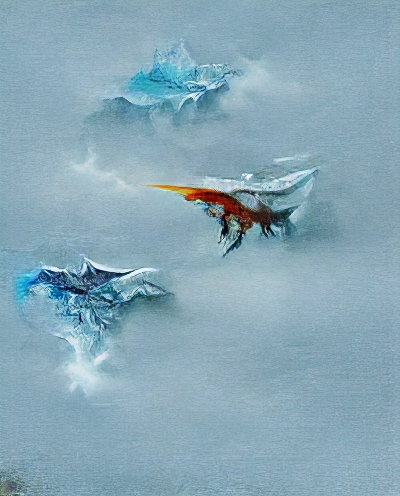

i: 80, loss: 0.709247, losses: 0.709247


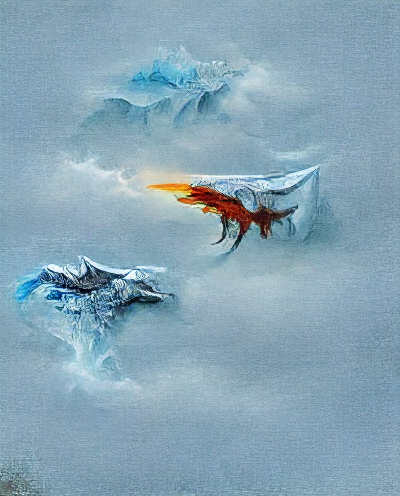

i: 100, loss: 0.73989, losses: 0.73989


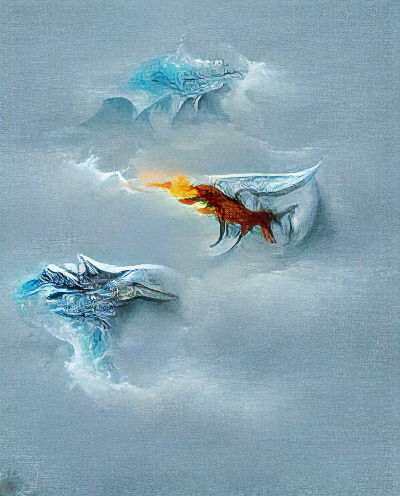

i: 120, loss: 0.702764, losses: 0.702764


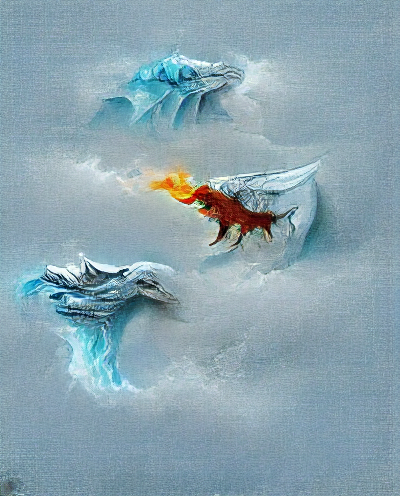

i: 140, loss: 0.700115, losses: 0.700115


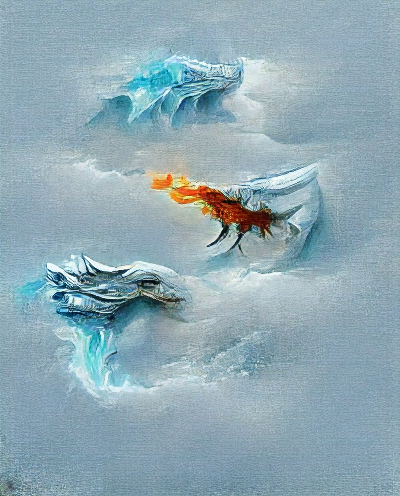

i: 160, loss: 0.701981, losses: 0.701981


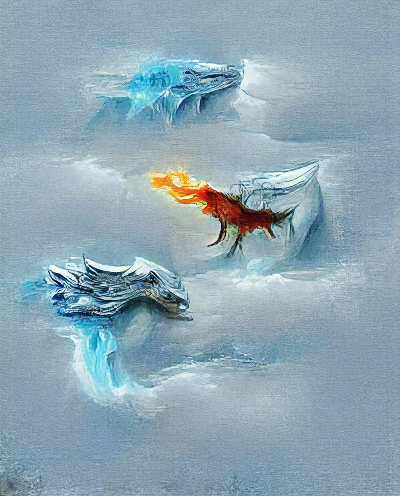

i: 180, loss: 0.697463, losses: 0.697463


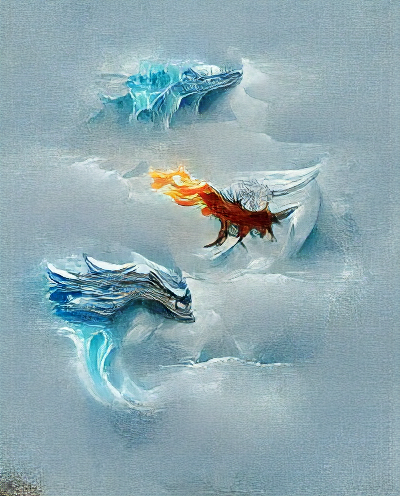

i: 200, loss: 0.683004, losses: 0.683004


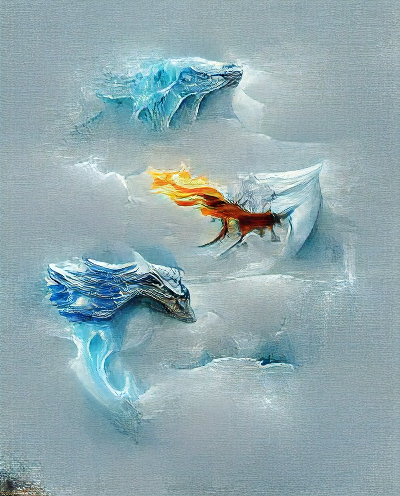

i: 220, loss: 0.710636, losses: 0.710636


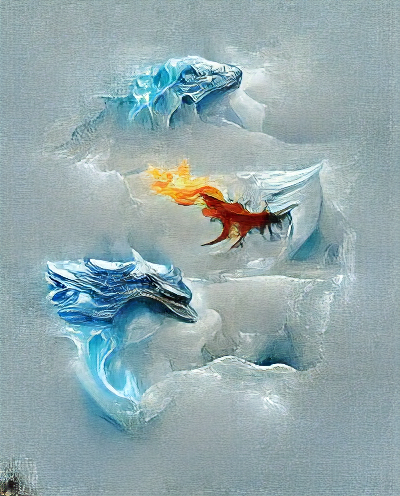

i: 240, loss: 0.691397, losses: 0.691397


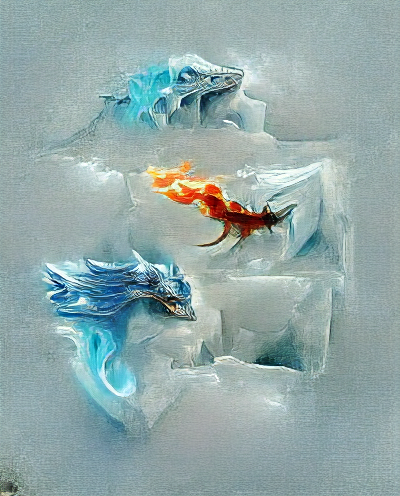

i: 260, loss: 0.691854, losses: 0.691854


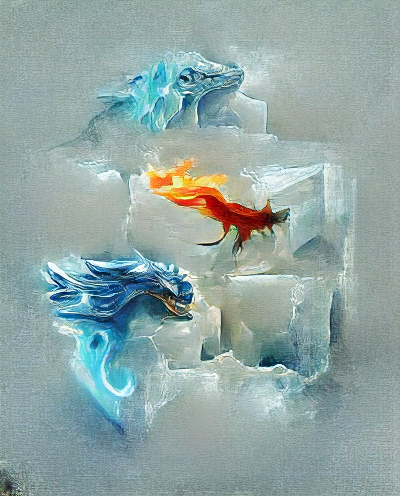

i: 280, loss: 0.675019, losses: 0.675019


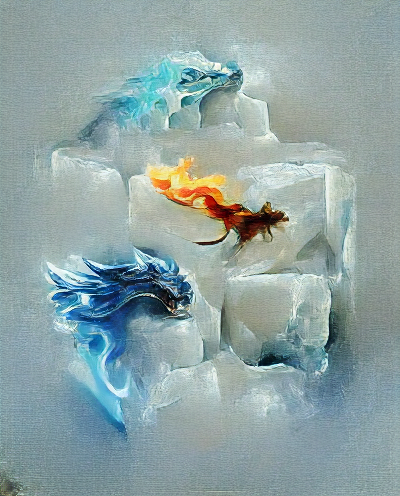

i: 300, loss: 0.669288, losses: 0.669288


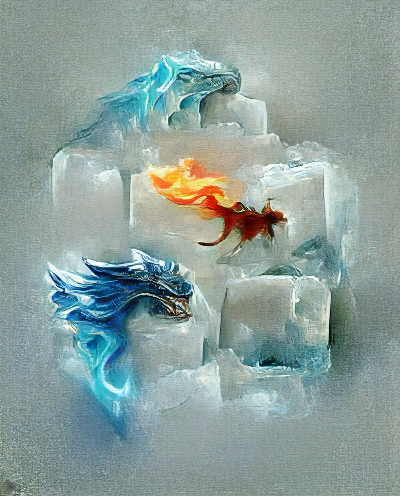

i: 320, loss: 0.668075, losses: 0.668075


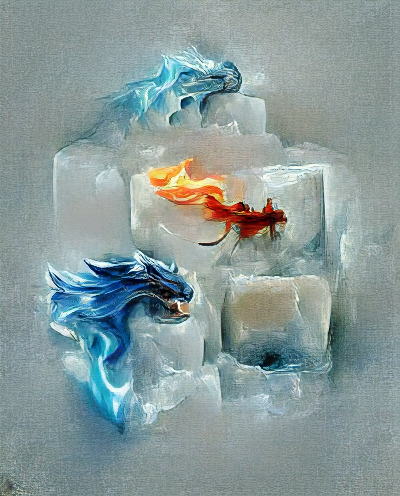

i: 340, loss: 0.654594, losses: 0.654594


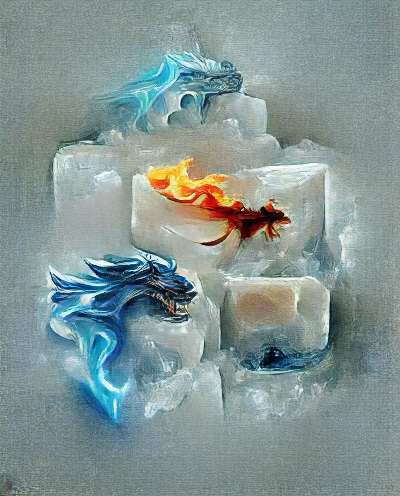

i: 360, loss: 0.682922, losses: 0.682922


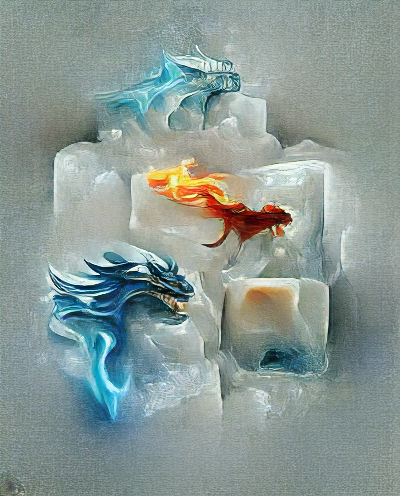

i: 380, loss: 0.659967, losses: 0.659967


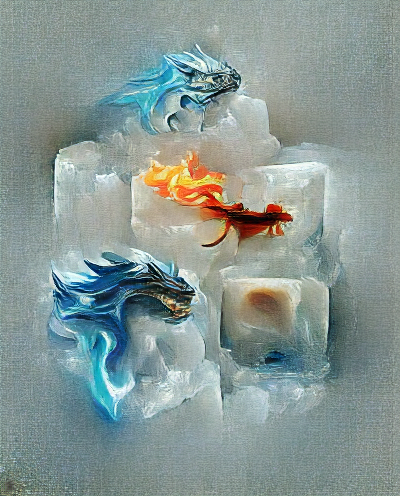

0:04:48.660477


In [ ]:
# @title #**Fire up the AI**


#@markdown ---

#Время
from datetime import datetime
import time
start_time = datetime.now()

#Loss
Loss_arr = []


device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)
if texts:
    print('Using texts:', texts)
if target_images:
    print('Using image prompts:', target_images)
if args.seed is None:
    seed = torch.seed()
else:
    seed = args.seed
torch.manual_seed(seed)
print('Using seed:', seed)

model = load_vqgan_model(args.vqgan_config, args.vqgan_checkpoint).to(device)
perceptor = clip.load(args.clip_model, jit=False)[0].eval().requires_grad_(False).to(device)

cut_size = perceptor.visual.input_resolution
if is_gumbel:
    e_dim = model.quantize.embedding_dim
else:
    e_dim = model.quantize.e_dim

f = 2**(model.decoder.num_resolutions - 1)
make_cutouts = MakeCutouts(cut_size, args.cutn, cut_pow=args.cut_pow)
if is_gumbel:
    n_toks = model.quantize.n_embed
else:
    n_toks = model.quantize.n_e

toksX, toksY = args.size[0] // f, args.size[1] // f
sideX, sideY = toksX * f, toksY * f
if is_gumbel:
    z_min = model.quantize.embed.weight.min(dim=0).values[None, :, None, None]
    z_max = model.quantize.embed.weight.max(dim=0).values[None, :, None, None]
else:
    z_min = model.quantize.embedding.weight.min(dim=0).values[None, :, None, None]
    z_max = model.quantize.embedding.weight.max(dim=0).values[None, :, None, None]

if args.init_image:
    pil_image = Image.open(args.init_image).convert('RGB')
    pil_image = pil_image.resize((sideX, sideY), Image.LANCZOS)
    z, *_ = model.encode(TF.to_tensor(pil_image).to(device).unsqueeze(0) * 2 - 1)
else:
    one_hot = F.one_hot(torch.randint(n_toks, [toksY * toksX], device=device), n_toks).float()
    if is_gumbel:
        z = one_hot @ model.quantize.embed.weight
    else:
        z = one_hot @ model.quantize.embedding.weight
    z = z.view([-1, toksY, toksX, e_dim]).permute(0, 3, 1, 2)
z_orig = z.clone()
z.requires_grad_(True)
#opt = optim.Adam([z], lr=args.step_size, weight_decay=0)
#opt = optim.Adam([z], lr=args.step_size, weight_decay=1.0e-2)
#opt = optim.Adam([z], lr=args.step_size, weight_decay=1.0e-4)
#opt = optim.Adam([z], lr=args.step_size, weight_decay=1.0e-8)
opt = optim.Adam([z], lr=args.step_size, weight_decay=1.0e-6)

normalize = transforms.Normalize(mean=[0.48145466, 0.4578275, 0.40821073],
                                 std=[0.26862954, 0.26130258, 0.27577711])

pMs = []

for prompt in args.prompts:
    txt, weight, stop = parse_prompt(prompt)
    embed = perceptor.encode_text(clip.tokenize(txt).to(device)).float()
    pMs.append(Prompt(embed, weight, stop).to(device))

for prompt in args.image_prompts:
    path, weight, stop = parse_prompt(prompt)
    img = resize_image(Image.open(path).convert('RGB'), (sideX, sideY))
    batch = make_cutouts(TF.to_tensor(img).unsqueeze(0).to(device))
    embed = perceptor.encode_image(normalize(batch)).float()
    pMs.append(Prompt(embed, weight, stop).to(device))

for seed, weight in zip(args.noise_prompt_seeds, args.noise_prompt_weights):
    gen = torch.Generator().manual_seed(seed)
    embed = torch.empty([1, perceptor.visual.output_dim]).normal_(generator=gen)
    pMs.append(Prompt(embed, weight).to(device))

def synth(z):
    if is_gumbel:
        z_q = vector_quantize(z.movedim(1, 3), model.quantize.embed.weight).movedim(3, 1)
    else:
        z_q = vector_quantize(z.movedim(1, 3), model.quantize.embedding.weight).movedim(3, 1)
    
    return clamp_with_grad(model.decode(z_q).add(1).div(2), 0, 1)

def add_xmp_data(nombrefichero):
    imagen = ImgTag(filename=nombrefichero)
    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'creator', 'VQGAN+CLIP', {"prop_array_is_ordered":True, "prop_value_is_array":True})
    if args.prompts:
        imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'title', " | ".join(args.prompts), {"prop_array_is_ordered":True, "prop_value_is_array":True})
    else:
        imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'title', 'None', {"prop_array_is_ordered":True, "prop_value_is_array":True})
    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'i', str(i), {"prop_array_is_ordered":True, "prop_value_is_array":True})
    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'model', name_model, {"prop_array_is_ordered":True, "prop_value_is_array":True})
    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'seed',str(seed) , {"prop_array_is_ordered":True, "prop_value_is_array":True})
    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'input_images',str(input_images) , {"prop_array_is_ordered":True, "prop_value_is_array":True})
    #for frases in args.prompts:
    #    imagen.xmp.append_array_item(libxmp.consts.XMP_NS_DC, 'Prompt' ,frases, {"prop_array_is_ordered":True, "prop_value_is_array":True})
    imagen.close()

def add_stegano_data(filename):
    data = {
        "title": " | ".join(args.prompts) if args.prompts else None,
        "notebook": "VQGAN+CLIP",
        "i": i,
        "model": name_model,
        "seed": str(seed),
        "input_images": input_images
    }
    lsb.hide(filename, json.dumps(data)).save(filename)

@torch.no_grad()
def checkin(i, losses):
    losses_str = ', '.join(f'{loss.item():g}' for loss in losses)
    tqdm.write(f'i: {i}, loss: {sum(losses).item():g}, losses: {losses_str}')
    Loss_arr.append(sum(losses))
    out = synth(z)
    TF.to_pil_image(out[0].cpu()).save('progress.png')
    add_stegano_data('progress.png')
    add_xmp_data('progress.png')
    display.display(display.Image('progress.png'))

def ascend_txt():
    global i
    out = synth(z)
    iii = perceptor.encode_image(normalize(make_cutouts(out))).float()

    result = []

    if args.init_weight:
        result.append(F.mse_loss(z, z_orig) * args.init_weight / 2)

    for prompt in pMs:
        result.append(prompt(iii))
    img = np.array(out.mul(255).clamp(0, 255)[0].cpu().detach().numpy().astype(np.uint8))[:,:,:]
    img = np.transpose(img, (1, 2, 0))
    filename = f"steps/{i:04}.png"
    imageio.imwrite(filename, np.array(img))
    add_stegano_data(filename)
    add_xmp_data(filename)
    return result

def train(i):
    opt.zero_grad()
    lossAll = ascend_txt()
    if i % args.display_freq == 0:
        checkin(i, lossAll)
    loss = sum(lossAll)
    loss.backward()
    opt.step()
    with torch.no_grad():
        z.copy_(z.maximum(z_min).minimum(z_max))

i = 0
try:
    with tqdm() as pbar:
        while True:
            train(i)
            if i == max_iterations:
                time.sleep(5)
                print(datetime.now() - start_time)
                break
            i += 1
            pbar.update()
except KeyboardInterrupt:
    pass

Text(0, 0.5, 'Loss')

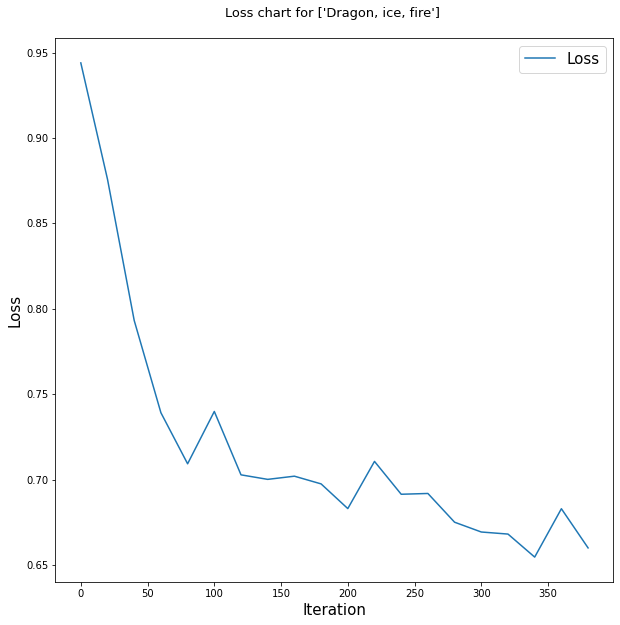

In [ ]:
# @title Make Loss plot
import matplotlib.pyplot as plt

x = []
j = images_interval
x.append(0)
while j<=max_iterations:
  x.append(j)
  j += images_interval

k=0
for k in range (int(max_iterations/images_interval+1)):
  Loss_arr[k]=float(Loss_arr[k])
  k +=1



plt.figure(figsize=(10, 10))
plt.plot(x, Loss_arr, label='Loss')
plt.legend(fontsize = 15)

plt.title('{} {} {}'.format('Loss chart for', texts, "\n"), fontsize = 13)
plt.xlabel("Iteration", fontsize = 15)
plt.ylabel("Loss", fontsize = 15)

In [ ]:
# @title Print loss array
print(Loss_arr)

[0.9440299272537231, 0.8758607506752014, 0.7931635975837708, 0.7391418814659119, 0.709247350692749, 0.7398902773857117, 0.702763557434082, 0.7001149654388428, 0.7019807696342468, 0.6974631547927856, 0.6830037832260132, 0.7106364369392395, 0.6913967728614807, 0.6918543577194214, 0.675019383430481, 0.6692879796028137, 0.6680749654769897, 0.6545939445495605, 0.68292236328125, 0.659967303276062]


#Video and images

In [ ]:
# @title Generate video
#@markdown **Generate a video with the result (You can edit frame rate and stuff by double-clicking this tab)**
init_frame = 1 #This is the frame where the video will start
last_frame = i #You can change i to the number of the last frame you want to generate. It will raise an error if that number of frames does not exist.

min_fps = 10
max_fps = 30

total_frames = last_frame-init_frame

length = 15 #Desired video time in seconds

frames = []
tqdm.write('Generating video...')
for i in range(init_frame,last_frame): #
    filename = f"steps/{i:04}.png"
    frames.append(Image.open(filename))

#fps = last_frame/10
fps = np.clip(total_frames/length,min_fps,max_fps)

from subprocess import Popen, PIPE
p = Popen(['ffmpeg', '-y', '-f', 'image2pipe', '-vcodec', 'png', '-r', str(fps), '-i', '-', '-vcodec', 'libx264', '-r', str(fps), '-pix_fmt', 'yuv420p', '-crf', '17', '-preset', 'veryslow', 'video.mp4'], stdin=PIPE)
for im in tqdm(frames):
    im.save(p.stdin, 'PNG')
p.stdin.close()

print("The video is now being compressed, wait...")
p.wait()
print("The video is ready")

Generating video...


  0%|          | 0/379 [00:00<?, ?it/s]

The video is now being compressed, wait...
The video is ready


In [ ]:
# @title Play video

mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display.HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
# @title Downloading video and img for later usage
from google.colab import files

files.download("video.mp4")
files.download("/content/steps/0380.png")
files.download("/content/steps/0320.png")
files.download("/content/steps/0240.png")
files.download("/content/steps/0160.png")
files.download("/content/steps/0080.png")
files.download("/content/steps/0020.png")

In [ ]:
#@title Download steps

from google.colab import files
import ipywidgets as widgets
from shutil import make_archive

make_archive('/content/steps', "zip", '/content/steps')
files.download(f"{'steps'}.zip")



# Delete 

In [ ]:
# @title Video removal
#@markdown Run this tab if you wanna delete video


%cd ..
%rm video.mp4

In [ ]:
# @title Zip removal
#@markdown Run this tab if you wanna delete zip file

%cd ..
%rm steps.zip

In [ ]:
# @title Frames removal
#@markdown Run this tab if you wanna clear all the genarated frames images

%cd ..
%cd content/steps
%rm *.png
%cd ..

/
/content/steps
/content


JS to prevent idle timeout:

Press F12 OR CTRL + SHIFT + I OR right click on this website -> inspect.
Then click on the console tab and paste in the following code.

```javascript
function ClickConnect(){
console.log("Working");
document.querySelector("colab-toolbar-button#connect").click()
}
setInterval(ClickConnect,60000)
```

# Text for book cover

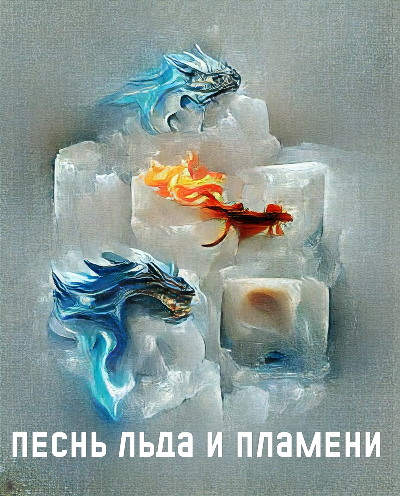

In [ ]:
# @title Parameters
back = "0380"#@param {type:"string"}
b_box = False #@param {type:"boolean"}

#@markdown #**Parameters for box**
#@markdown ---
b_width =  100#@param {type:"number"}
b_height =  40#@param {type:"number"}
#@markdown ---
b_x =  10#@param {type:"number"}
b_y =  200#@param {type:"number"}
#@markdown ---
b_color = "15, 33, 47"#@param {type:"string"}
b_rotate = 0#@param {type: "number"}

#@markdown #**Parameters for text**
#@markdown ---
t_text = "\u041F\u0435\u0441\u043D\u044C \u043B\u044C\u0434\u0430 \u0438 \u043F\u043B\u0430\u043C\u0435\u043D\u0438" #@param {type:"string"}
t_font = "KTFJermilov-Solid" #@param ["1", "NAMU-1400", "NAMU-1930", "KTFJermilov-Solid"]
t_fontsize =  35#@param {type:"number"}
t_color = "255, 255, 255"#@param {type:"string"}
t_x =  10#@param {type:"number"}
t_y =  420#@param {type:"number"}
t_rotate = 0#@param {type: "number"}

from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont,  ImageOps
from IPython import display

# Open an Image
img = Image.open('{}.png'.format(back))

# Call draw Method to add 2D graphics in an image
I1 = ImageDraw.Draw(img)


#Add box to image
if b_box:
    b_color=list(b_color.split(","))
    b_color = list(map(int, b_color))
    box=Image.new(mode = "RGB", size=(b_width,b_height), color=(b_color[0], b_color[1], b_color[2]))
    front=box.rotate(b_rotate,  expand=1)
    mask = Image.new('L', box.size, 255)
    mask = mask.rotate(b_rotate, expand=True)
    img.paste(front, (b_x, b_y), mask)


t_color=list(t_color.split(","))
t_color = list(map(int, t_color))
# Add Text to an image
myFont = ImageFont.truetype('{}.ttf'.format(t_font), t_fontsize)
txt=Image.new('L', myFont.getsize(t_text))
d = ImageDraw.Draw(txt)
d.text( (0, 0), t_text,  font=myFont, fill=255)
w=txt.rotate(t_rotate,  expand=1)

mask = Image.new('L', myFont.getsize(t_text), 255)
mask = mask.rotate(t_rotate, expand=True)

img.paste(ImageOps.colorize(w, (0,0,0), (t_color[0], t_color[1], t_color[2])), (t_x,t_y),  w)

# Save the edited image
img.save('f_{}.png'.format(back))
display.display(display.Image('f_{}.png'.format(back)))

In [ ]:
# @title Download cover

from google.colab import files
files.download('f_{}.png'.format(back))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#Searching

Text(0, 0.5, 'Loss')

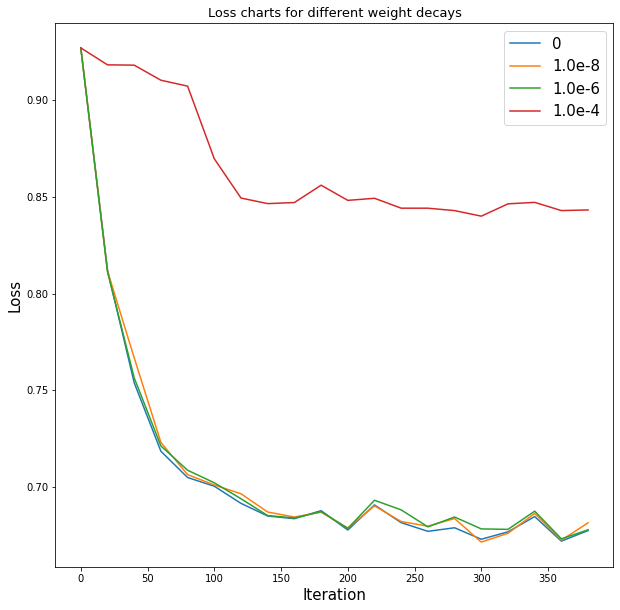

In [ ]:
# @title Loss charts for different weight decays
import matplotlib.pyplot as plt

x = []
j = 0
while j<=380:
  x.append(j)
  j += 20

wd0 = [0.9269452095031738, 0.8121939897537231, 0.7539105415344238, 0.7185214757919312, 0.704953134059906, 0.7004604339599609, 0.6915866732597351, 0.6850647926330566, 0.6836849451065063, 0.6878330707550049, 0.677826464176178, 0.690799355506897, 0.6816245913505554, 0.6771520376205444, 0.6789882183074951, 0.6730613112449646, 0.6768860816955566, 0.6847780346870422, 0.67207270860672, 0.6775692701339722]
wd1e8 = [0.9269452095031738, 0.8116931319236755, 0.7667902708053589, 0.7230764627456665, 0.7064422369003296, 0.7011063694953918, 0.696553111076355, 0.687124490737915, 0.6845275163650513, 0.68707275390625, 0.6788502931594849, 0.6902874708175659, 0.6822194457054138, 0.6798068881034851, 0.6837631464004517, 0.6715885400772095, 0.6761378049850464, 0.6863793134689331, 0.6725719571113586, 0.6815758943557739]
wd1e6 = [0.9269452095031738, 0.8111591339111328, 0.7564361095428467, 0.7212514877319336, 0.7087187767028809, 0.7022255659103394, 0.6939835548400879, 0.685283899307251, 0.6840370297431946, 0.6873204708099365, 0.6786460876464844, 0.6932119727134705, 0.6882235407829285, 0.6794602870941162, 0.6845481395721436, 0.6783936023712158, 0.678166389465332, 0.6875677108764648, 0.6732689738273621, 0.6779429912567139]
wd1e4 = [0.9269452095031738, 0.9181945323944092, 0.9180336594581604, 0.9102483987808228, 0.90718674659729, 0.86963951587677, 0.8493693470954895, 0.8464874029159546, 0.8470463752746582, 0.8559983372688293, 0.8481642007827759, 0.8492429256439209, 0.8441291451454163, 0.8441190123558044, 0.8428772687911987, 0.840003252029419, 0.8463717103004456, 0.8471289873123169, 0.8428936004638672, 0.8432198166847229]


plt.figure(figsize=(10, 10))
plt.plot(x, wd0, label='0')
plt.plot(x, wd1e8, label='1.0e-8')
plt.plot(x, wd1e6, label='1.0e-6')
plt.plot(x, wd1e4, label='1.0e-4')
plt.legend()
plt.legend(fontsize = 15)

plt.title('Loss charts for different weight decays', fontsize = 13)
plt.xlabel("Iteration", fontsize = 15)
plt.ylabel("Loss", fontsize = 15)

Text(0, 0.5, 'Loss')

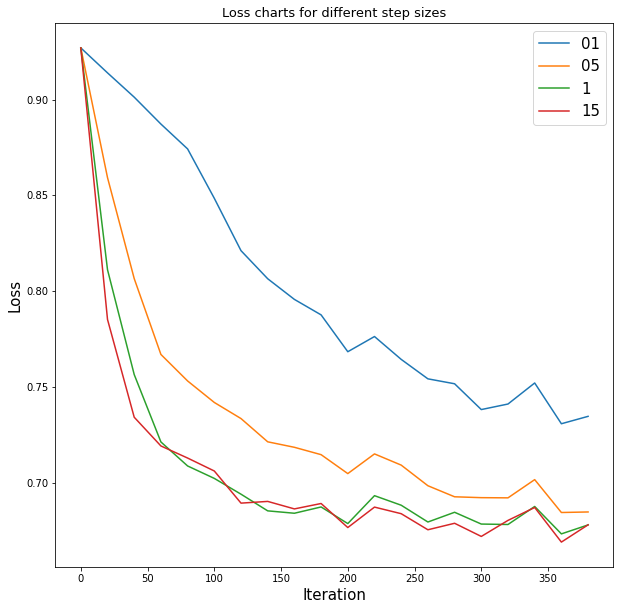

In [ ]:
# @title Loss charts for different step sizes
import matplotlib.pyplot as plt

x = []
j = 0
while j<=380:
  x.append(j)
  j += 20

s01 = [0.9269452095031738, 0.9139179587364197, 0.9012378454208374, 0.8871999979019165, 0.8742166757583618, 0.8484371900558472, 0.8211030960083008, 0.8064498901367188, 0.7956647276878357, 0.7875835299491882, 0.7683534622192383, 0.776283860206604, 0.7643561363220215, 0.7541987895965576, 0.7516242265701294, 0.7381574511528015, 0.7410527467727661, 0.7520327568054199, 0.730757474899292, 0.7346194386482239]
s05 = [0.9269452095031738, 0.8592394590377808, 0.8065323233604431, 0.7669284343719482, 0.7530919313430786, 0.741868257522583, 0.7334581613540649, 0.7213228344917297, 0.7184614539146423, 0.714619517326355, 0.7047330141067505, 0.7150130271911621, 0.7091652154922485, 0.6983982920646667, 0.6926270723342896, 0.6921724081039429, 0.6920738220214844, 0.7015857100486755, 0.6844242811203003, 0.684705376625061]
s1 = [0.9269452095031738, 0.8111591339111328, 0.7564361095428467, 0.7212514877319336, 0.7087187767028809, 0.7022255659103394, 0.6939835548400879, 0.685283899307251, 0.6840370297431946, 0.6873204708099365, 0.6786460876464844, 0.6932119727134705, 0.6882235407829285, 0.6794602870941162, 0.6845481395721436, 0.6783936023712158, 0.678166389465332, 0.6875677108764648, 0.6732689738273621, 0.6779429912567139]
s15 = [0.9269452095031738, 0.7851901650428772, 0.7341558337211609, 0.7191596627235413, 0.7128515243530273, 0.7060914039611816, 0.689319908618927, 0.6902151107788086, 0.6863027215003967, 0.6891236901283264, 0.6765717267990112, 0.6872423887252808, 0.6838036775588989, 0.6754142642021179, 0.6788003444671631, 0.6719315648078918, 0.6803103685379028, 0.6870406866073608, 0.6689795255661011, 0.6779988408088684]

plt.figure(figsize=(10, 10))
plt.plot(x, s01, label='01')
plt.plot(x, s05, label='05')
plt.plot(x, s1, label='1')
plt.plot(x, s15, label='15')
plt.legend()
plt.legend(fontsize = 15)

plt.title('Loss charts for different step sizes', fontsize = 13)
plt.xlabel("Iteration", fontsize = 15)
plt.ylabel("Loss", fontsize = 15)